# Live Demo for "Climate Data + Modeling for the Financial Sector" on September 22 2023

In [9]:
import numpy as np
import xarray as xr
import hvplot.xarray # noqa
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from dask.diagnostics import ProgressBar
import panel.widgets as pnw

In [55]:
def create_area_weights(ds):
    return np.cos(np.deg2rad(ds.lat))

In [5]:
store = 'https://carbonplan-data-viewer.s3.amazonaws.com/demo/dryspells_corn/CanESM5-ssp370-full-time-extent.zarr'
ds = xr.open_dataset(store, engine='zarr', chunks={})
ds

<xarray.Dataset>
Dimensions:              (time: 84, lat: 600, lon: 1440)
Coordinates:
  * lat                  (lat) float64 -59.88 -59.62 -59.38 ... 89.62 89.88
  * lon                  (lon) float64 0.125 0.375 0.625 ... 359.4 359.6 359.9
  * time                 (time) datetime64[ns] 2015-01-01 ... 2098-01-01
Data variables:
    CornEnergy           (time, lat, lon) float32 dask.array<chunksize=(84, 128, 128), meta=np.ndarray>
    CornLikely           (time, lat, lon) float32 dask.array<chunksize=(84, 128, 128), meta=np.ndarray>
    CornLikely_binary    (time, lat, lon) bool dask.array<chunksize=(84, 128, 128), meta=np.ndarray>
    CornPossible         (time, lat, lon) float32 dask.array<chunksize=(84, 128, 128), meta=np.ndarray>
    CornPossible_binary  (time, lat, lon) bool dask.array<chunksize=(84, 128, 128), meta=np.ndarray>
    CornSafe             (time, lat, lon) float32 dask.array<chunksize=(84, 128, 128), meta=np.ndarray>
    CornSafe_binary      (time, lat, lon) bool dask.array<chunksize=(84, 128, 128), meta=np.ndarray>
    DrySpellFraction     (time, lat, lon) float32 dask.array<chunksize=(84, 128, 128), meta=np.ndarray>
    dry_spell_days       (time, lat, lon) float32 dask.array<chunksize=(84, 128, 128), meta=np.ndarray>

In [6]:
with ProgressBar():
    ds = ds.persist()

[########################################] | 100% Completed | 4.35 sms


## Explore the data

In [22]:
ds.CornPossible.isel(time=slice(0,None,5)).hvplot.quadmesh(
    'lon', 'lat', projection=ccrs.Robinson(),
    global_extent=True,
    cmap='viridis',
    # project=True,
    geo=True,
    rasterize=True,
    coastline=True,
    frame_width=800,
    dynamic=False,
)

:HoloMap   [time]
   :Overlay
      .Image.I     :Image   [lon,lat]   (CornPossible)
      .Coastline.I :Feature   [Longitude,Latitude]

## Quantify changes

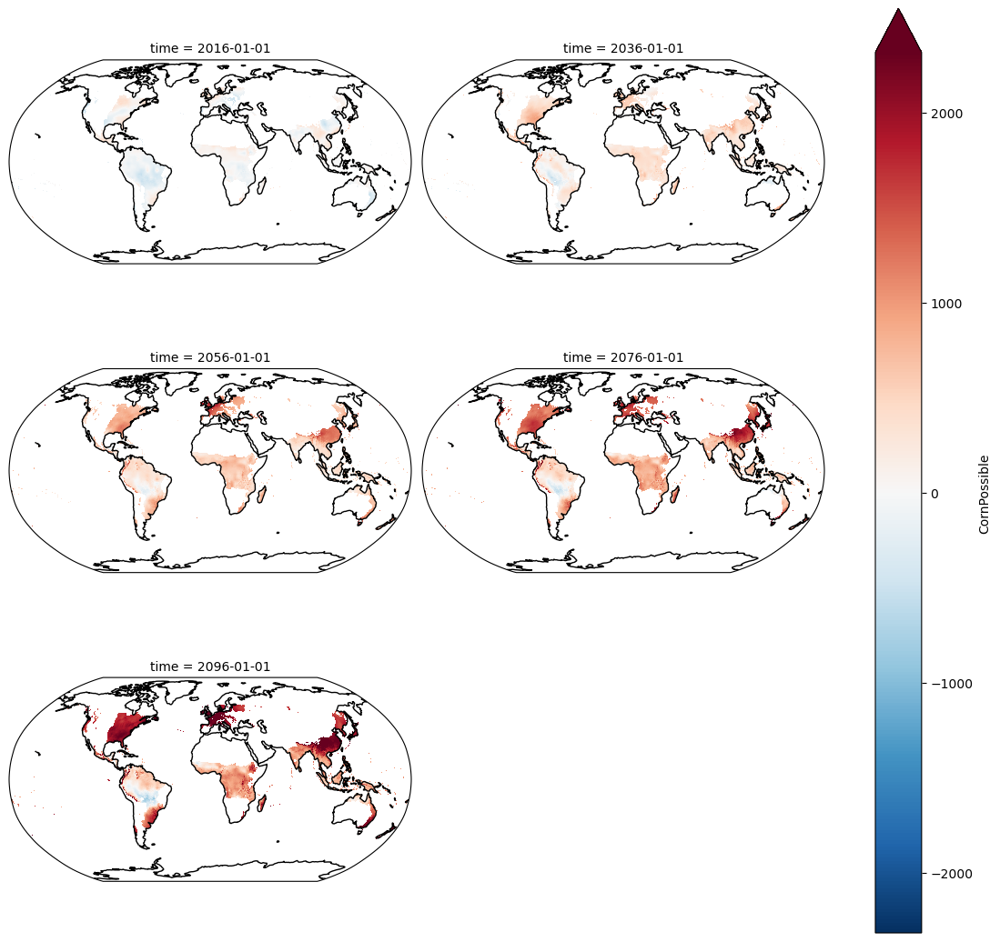

In [7]:
# select the data every 10th time step starting from the first time step for the variable "CornPossible", 
# and then subtracts the value of "CornPossible" at the 0th time step from it
dset = ds.isel(time=slice(1, None, 20)).CornPossible - ds.isel(time=0).CornPossible


# Create a plot of the new dataset "dset", with each subplot corresponding to a different time step
# The argument "col='time'" specifies that the subplots should be arranged in columns based on time, 
# with three columns per row. The "robust=True" argument sets the scaling of the color axis to account for outliers in the data.
a = dset.plot(col='time', robust=True, size=3.5, aspect=1.5, col_wrap=2, subplot_kws={'projection': ccrs.Robinson(0)}, transform=ccrs.PlateCarree(),);
for ax in a.axs.flat:
    ax.coastlines()

### Which regions gained/lost the ability to support corn growth?

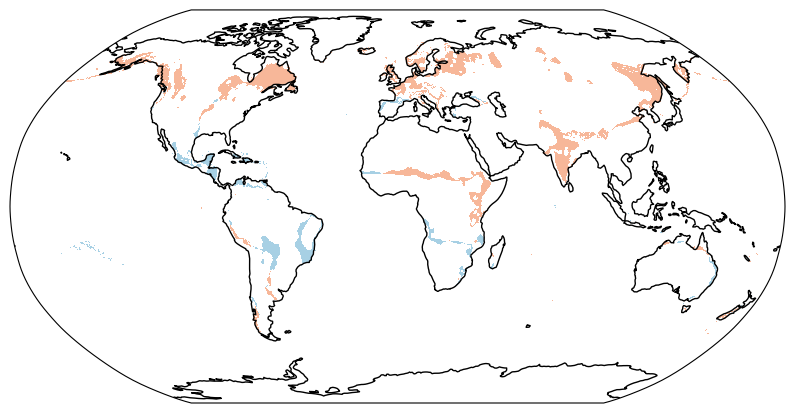

In [8]:
# this just showed the change in regions where corn growth was previously possible
# How about new areas that will support corn growth in the future?
future_growth_mask = ds.isel(time=slice(-10, None)).CornPossible.notnull().all('time')
current_growth_mask = ds.isel(time=slice(0,10)).CornPossible.notnull().all('time')

gained_growth_mask = np.logical_and(future_growth_mask, ~current_growth_mask)
lost_growth_mask = np.logical_and(~future_growth_mask, current_growth_mask)

fig, ax = plt.subplots(subplot_kw={'projection':ccrs.Robinson()}, figsize=[10,7])
kwargs = dict(ax=ax, transform=ccrs.PlateCarree())
gained_growth_mask.where(gained_growth_mask==1).plot(cmap='RdBu_r', vmin=0, vmax=1.5, add_colorbar=False, **kwargs)
lost_growth_mask.where(lost_growth_mask==1).plot(cmap='RdBu', vmin=0, vmax=1.5, add_colorbar=False, **kwargs)
ax.coastlines()
ax.set_global()

## Combining different datasets
https://leap-data-catalog-git-katamartin-demo-carbonplan.vercel.app


In [54]:

import xarray as xr

store = 'https://carbonplan-data-viewer.s3.amazonaws.com/demo/ScenarioMIP.CCCma.CanESM5.ssp245.r1i1p1f1.annual.GARD-SV.tasmax.zarr'
ds_temp = xr.open_dataset(store, engine='zarr', chunks={})
ds_temp

<xarray.Dataset>
Dimensions:  (lat: 721, lon: 1440, time: 85)
Coordinates:
  * lat      (lat) float32 -90.0 -89.75 -89.5 -89.25 ... 89.25 89.5 89.75 90.0
  * lon      (lon) float32 -180.0 -179.8 -179.5 -179.2 ... 179.2 179.5 179.8
  * time     (time) datetime64[ns] 2015-01-01 2016-01-01 ... 2099-01-01
Data variables:
    tasmax   (time, lat, lon) float32 dask.array<chunksize=(85, 128, 128), meta=np.ndarray>
Attributes: (12/17)
    Conventions:                     CF-1.8
    activity_id:                     ScenarioMIP
    cmip6_downscaling_contact:       hello@carbonplan.org
    cmip6_downscaling_explainer:     https://carbonplan.org/research/cmip6-do...
    cmip6_downscaling_institution:   CarbonPlan
    cmip6_downscaling_license:       CC-BY-4.0
    ...                              ...
    institution_id:                  CCCma
    member_id:                       r1i1p1f1
    references:                      Eyring, V., Bony, S., Meehl, G. A., Seni...
    source_id:                       CanESM5
    timescale:                       day
    variable_id:                     tasmax

In [60]:
mean_corn = ds.CornPossible.weighted(create_area_weights(ds)).mean(['lon','lat'])
mean_temp = ds_temp.isel(time=slice(None, -1)).tasmax.weighted(create_area_weights(ds_temp)).mean(['lon','lat'])

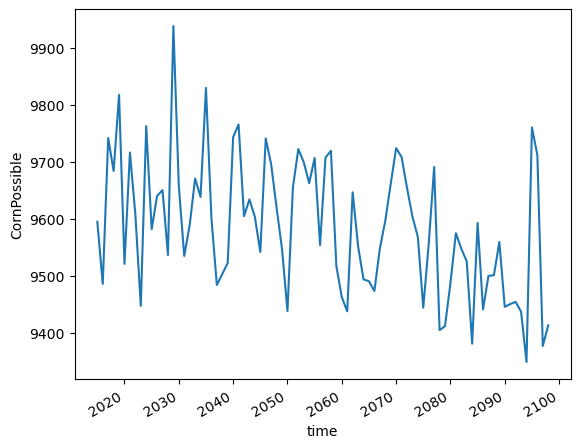

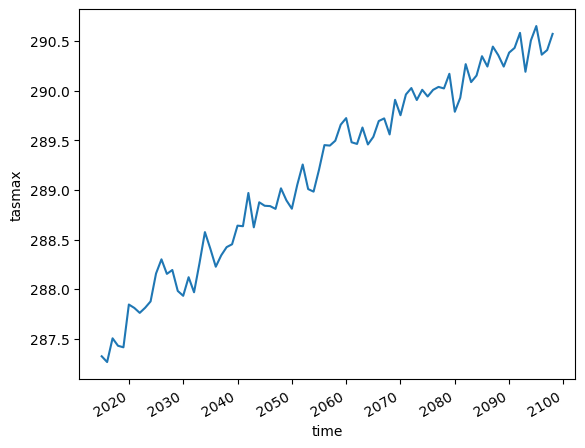

In [61]:
mean_corn.plot()
plt.figure()
mean_temp.plot()

Text(0, 0.5, 'average daily max temperature')

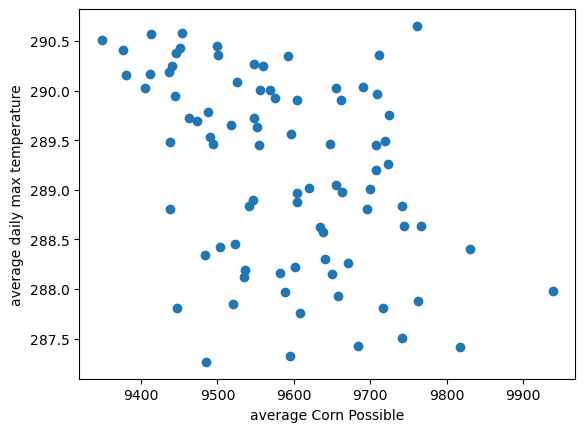

In [63]:
plt.scatter(mean_corn, mean_temp)
plt.xlabel('average Corn Possible')
plt.ylabel('average daily max temperature')

## Do you like this way of working? 

![](https://media.giphy.com/media/3WCNY2RhcmnwGbKbCi/giphy.gif)

### Yes? Get acces to the LEAP-Pangeo Jupyterhub by signing up

![](https://media.giphy.com/media/STfLOU6iRBRunMciZv/giphy.gif)

### No? You can access data with your own favorite tools. The Platform is fully modular.